# Stabilities and accuracy in time. 

Lets consider same setup as in [ex_3a](https://github.com/AST-Course/AST5110/blob/main/ex_3a.ipynb) Burgers’ equation, i.e.,

$$\frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} = 0   \tag{1}$$ 

for the domain $x \in (x_0, x_f)$ with $x_0 = −1.4$, $x_f = 2.0$ with initial condition:

$$u(x,t=0) = A\left[\tanh\left(\frac{x+x_c}{W}\right)-\tanh\left(\frac{x-x_c}{W}\right)\right]   \tag{2}$$

whereby $A = 0.02$ , $x_c = 0.70$, $W = 0.1$. Let the solution evolve until time $t_f = 100$. Explain in physical (or mathematical) terms the solution you get. However, let's now implement a new time-step method. 

Add the following method to your library and run the previous simulation. 

$$u^{n+1}_j = \frac{1}{2}(u^n_{j+1} + u^n_{j-1}) - \frac{v \Delta t}{2 \Delta x}(u^n_{j+1} - u^n_{j-1})$$

Apply von Neumann stability analysis to the expression above. The stability condition $|\xi(k)|^2 \leq 1$ leads to the famous Courant-Friedrichs-Lewy (CFL) stability. 

Add this to your library and solve the previous simulation imposing the CFL condition. For this exercise, fill in `nm_lib` the function `evolv_Lax_uadv_burgers`. 

In [1]:
import numpy as np 
import matplotlib.pyplot as plt 
from nm_lib import nm_lib as nm
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

In [2]:
def initial_u(xx):
    A = 0.02
    x_c = 0.7
    W = 0.1

    return A*(np.tanh((x+x_c)/W) - np.tanh((x-x_c)/W))

In [3]:
nint = 128
nump = nint+1
x0 = -1.4
xf = 2

x = np.linspace(x0,xf, nump)
u0 = initial_u(x)

nt = 3900
a = -1
t, un = nm.evolv_adv_burgers(x, u0, nt,a)

# print(t[-1])

In [4]:
# plt.figure(figsize=(10,5))
# idx = -40

# plt.plot(x, un[:,0])
# plt.plot(x, un[:,idx])
# plt.xlabel("x")
# plt.ylabel("u")
# plt.title(f"t = {t[idx]:.0f}")
# plt.show()

In [5]:
nint = 128
nump = nint+1
x0 = -1.4
xf = 2

x = np.linspace(x0,xf, nump)
u0 = initial_u(x)

nt = 200
a = -1

t, un = nm.evolv_Lax_uadv_burgers(x, u0, nt, ddx = nm.deriv_cent, bnd_limits=[1,1])

In [6]:
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un[:,0])

def animate(i):
 
    axes.clear()
    # axes.plot(x,un[:,::10][:,i])
    axes.plot(x,un[:,i])
    axes.set_title('t=%.2f'%t[i])
    
anim = FuncAnimation(fig, animate, interval=50, frames=nt, init_func=init)
HTML(anim.to_jshtml())

In [7]:
plt.close()

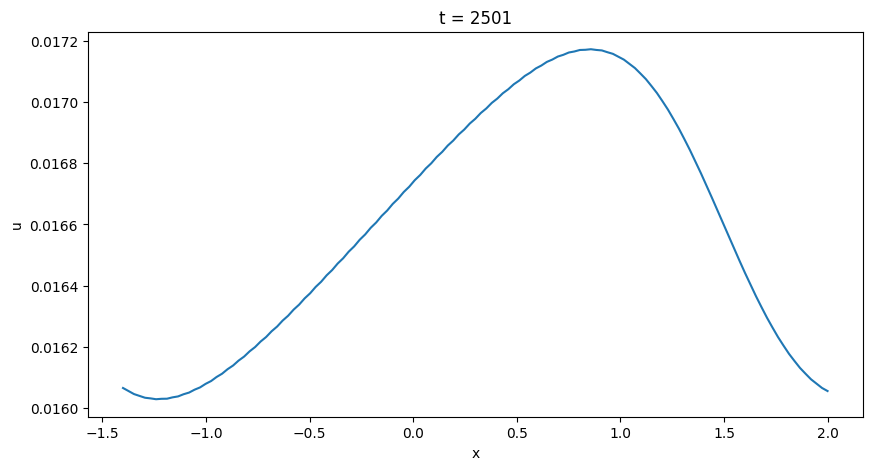

In [8]:

nt = 2000

t, un = nm.evolv_Lax_uadv_burgers(x, u0, nt, ddx = nm.deriv_cent, bnd_limits=[1,1])

plt.figure(figsize=(10,5))
idx = -40

#plt.plot(x, un[:,0])
plt.plot(x, un[:,idx])
plt.xlabel("x")
plt.ylabel("u")
plt.title(f"t = {t[idx]:.0f}")
plt.show()

## 1- Diffusive. 

Redo the exercise [ex_2b](https://github.com/AST-Course/AST5110/blob/main/ex_2b.ipynb) and compare the two methods, i.e., one from 
[ex_2b](https://github.com/AST-Course/AST5110/blob/main/ex_2b.ipynb) and the Lax-Method. 

Which one is more diffusive? Why? Rewrite Lax-method, so the right-hand side is as follows: 

$$\frac{u^{n+1}-u^{n}}{\Delta t} = ...$$

What is the reminder term look like? Is the order of convergence the same for the two methods? 

In [21]:
nint = 128
nump = nint+1
x0 = -1.4
xf = 2

x = np.linspace(x0,xf, nump)
u0 = initial_u(x)

nt = 2000
a = -1

t_up, un_up = nm.evolv_uadv_burgers(x, u0, nt, ddx = nm.deriv_upw, bnd_limits=[0,1])
t, un = nm.evolv_Lax_uadv_burgers(x, u0, nt, ddx = nm.deriv_cent, bnd_limits=[1,1])

# print(x.size)
# print(t_up.size)
# print(un_up.shape)

# print(un_up[:,::10].shape)

c:\users\eier\documents\masters\ast5110\nm_lib\nm_lib\nm_lib.py:141: RuntimeWarning: overflow encountered in divide
  return np.min(dx/np.abs(a))
c:\users\eier\documents\masters\ast5110\nm_lib\nm_lib\nm_lib.py:141: RuntimeWarning: divide by zero encountered in divide
  return np.min(dx/np.abs(a))
c:\users\eier\documents\masters\ast5110\nm_lib\nm_lib\nm_lib.py:438: RuntimeWarning: overflow encountered in multiply
  rhs = -hh[bnd_limits[0]:d- bnd_limits[1]]*ddx(xx,hh)
c:\users\eier\documents\masters\ast5110\nm_lib\nm_lib\nm_lib.py:438: RuntimeWarning: invalid value encountered in multiply
  rhs = -hh[bnd_limits[0]:d- bnd_limits[1]]*ddx(xx,hh)
c:\users\eier\documents\masters\ast5110\nm_lib\nm_lib\nm_lib.py:294: RuntimeWarning: invalid value encountered in multiply
  un[bnd_limits[0]:d- bnd_limits[1],i+1] = hh[bnd_limits[0]:d- bnd_limits[1]] + rhs*dt


In [22]:
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un_up[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,un_up[:,::10][:,i])
    axes.set_title('t=%.2f'%t_up[::10][i])
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t_up[::10]), init_func=init)
HTML(anim.to_jshtml())

In [23]:
plt.close()

In [24]:
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,un[:,::10][:,i])
    axes.set_title('t=%.2f'%t[::10][i])
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t[::10]), init_func=init)
HTML(anim.to_jshtml())

In [25]:
plt.close()

In [26]:
same = np.where(np.abs(t-t_up) < 5 )[0]
print(len(same))

un_new = un[:,same]
un_up_new = un_up[:,same]
t_new = t[same]
t_up_new = t_up[same]

16


In [27]:
plt.ioff()

fig, axes = plt.subplots(nrows=1, ncols=1, figsize=(10, 5))

def init(): 
    axes.plot(x,un_new[:,0])
    axes.plot(x,un_up_new[:,0])

def animate(i):
 
    axes.clear()
    axes.plot(x,un_new[:,::10][:,i])
    axes.plot(x,un_up_new[:,::10][:,i])
    axes.set_title('t=%.2f'%t_new[::10][i])
    
anim = FuncAnimation(fig, animate, interval=50, frames=len(t_new[::10]), init_func=init)
HTML(anim.to_jshtml())

In [28]:
plt.close()

In [35]:


# plt.figure(figsize=(10,5))

# plt.plot(x, un[:,same[40]], label="upwind")
# plt.plot(x, un_up[:,same[40]], label="LAX")
# plt.show()




------------------------
Hello
[ 8.77851062e-07  1.49327261e-06  2.54013547e-06  4.32089630e-06
  7.35003524e-06  1.25026663e-05  2.12672748e-05  3.61754731e-05
  6.15325598e-05  1.04658858e-04  1.77997295e-04  3.02686931e-04
  5.14608287e-04  8.74570252e-04  1.48536075e-03  2.51995384e-03
  4.26721936e-03  7.20326765e-03  1.20950515e-02  2.01289040e-02
  3.30079020e-02  5.28379568e-02  8.14017642e-02  1.18288995e-01
  1.58069703e-01  1.89129106e-01  1.98534485e-01  1.81735716e-01
  1.46656028e-01  1.06772237e-01  7.20483384e-02  4.61587455e-02
  2.85964651e-02  1.73494509e-02  1.03926101e-02  6.17788494e-03
  3.65574713e-03  2.15744830e-03  1.27119600e-03  7.48301420e-04
  4.40250663e-04  2.58929120e-04  1.52256212e-04  8.95178738e-05
  5.26241800e-05  3.09282966e-05  1.81661046e-05  1.06517856e-05
  6.21477685e-06  3.57328866e-06  1.96418679e-06  9.22580087e-07
  1.47528001e-07 -5.84899752e-07 -1.48631873e-06 -2.81716805e-06
 -4.96195181e-06 -8.54031528e-06 -1.45860267e-05 -2.4845515

In [38]:
print(nm.deriv_upw(x,u0) - nm.deriv_dnw(x,u0))


[0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0. 0.
 0. 0. 0. 0. 0. 0. 0. 0.]


In [37]:

print(nm.deriv_dnw(x,u0))

[ 8.77851062e-07  1.49327261e-06  2.54013547e-06  4.32089630e-06
  7.35003524e-06  1.25026663e-05  2.12672748e-05  3.61754731e-05
  6.15325598e-05  1.04658858e-04  1.77997295e-04  3.02686931e-04
  5.14608287e-04  8.74570252e-04  1.48536075e-03  2.51995384e-03
  4.26721936e-03  7.20326765e-03  1.20950515e-02  2.01289040e-02
  3.30079020e-02  5.28379568e-02  8.14017642e-02  1.18288995e-01
  1.58069703e-01  1.89129106e-01  1.98534485e-01  1.81735716e-01
  1.46656028e-01  1.06772237e-01  7.20483384e-02  4.61587455e-02
  2.85964651e-02  1.73494509e-02  1.03926101e-02  6.17788494e-03
  3.65574713e-03  2.15744830e-03  1.27119600e-03  7.48301420e-04
  4.40250663e-04  2.58929120e-04  1.52256212e-04  8.95178738e-05
  5.26241800e-05  3.09282966e-05  1.81661046e-05  1.06517856e-05
  6.21477685e-06  3.57328866e-06  1.96418679e-06  9.22580087e-07
  1.47528001e-07 -5.84899752e-07 -1.48631873e-06 -2.81716805e-06
 -4.96195181e-06 -8.54031528e-06 -1.45860267e-05 -2.48455152e-05
 -4.22820403e-05 -7.19306

---

(\*) Equation (1) is, in fact, a shortened version of the full Burgers’ equation, which contains a viscosity term on the right-hand side, as follows:
$$\frac{\partial u}{\partial t} + u \frac{\partial u}{\partial x} = \nu \frac{\partial^2 u}{\partial x^2}.$$

<span style="color:green"> JMS.  </span>.

<span style="color:red"> The problem is with the deriv_center. The derivation is as follows: </span>.

$(u_{i+1}-u_{i-1})/(x_{i+1}-x_{i-1})$

if you assume, for instance $dx=x_{i+1}-x_{i}$, then you can add teh $2\times dx$ but not add the 2\times when you have already $x_{i+1}-x_{i-1}$. Is that clear? 